In [20]:
import pandas as pd
import numpy as np
from pyarrow import Table
import pyarrow.dataset as ds
import pyarrow.compute as pc
import pyarrow.parquet as pq
import matplotlib.pyplot as plt
from source import *
from pathlib import Path

import scienceplots

plt.style.use(['science','ieee', 'grid'])
prop_cycle = plt.rcParams['axes.prop_cycle']
colors = prop_cycle.by_key()['color']

In [21]:
sig = ds.dataset(list(Path(f"new_sig/").glob("*.parquet")), format="parquet")

In [22]:
lep = ds.dataset(list(Path(f"halfleptonic/").glob("*.parquet")), format="parquet")

In [23]:
scanner = lep.scanner(batch_size=100_000)
for batch in scanner.to_batches():
    table = Table.from_batches([batch])
    display(table.to_pandas().columns)
    break
del scanner

Index(['__experiment__', '__run__', '__event__', '__production__', 'pcm',
       'ecm', 'missedE', 'recM2_Ups', 'pmiss', 'cmpmiss', 'thetamiss',
       'cmthetamiss', 'fox', 'asymmetry', 'p0', 'theta_Bs', 'M0', 'recM2_Bs',
       'idec0', 'idec1', 'is0', 'N_KL', 'Miss_id_0', 'Miss_id_1', 'Bs_lik',
       'N_KS', 'theta_tau_0', 'p_tau_0', 'theta_tau_1', 'p_tau_1', 'tau_d_0_0',
       'tau_d_1_0', 'tau_last_z_0', 'tau_last_r_0', 'tau_last_z_1',
       'tau_last_r_1', 'Istau0', 'Istau1', 'Chi_sq_0', 'Chi_sq_1', 'dr0',
       'dr1', 'totalEnergyMC', 'E_gamma_in_ROE', 'correct_nu_0',
       'correct_nu_1', 'correct_gamma_0', 'correct_gamma_1', 'lost_0',
       'lost_1', 'PID_self_vs_0_tau0', 'PID_self_vs_1_tau0',
       'PID_self_vs_2_tau0', 'PID_self_vs_4_tau0', 'PID_self_vs_0_tau1',
       'PID_self_vs_1_tau1', 'PID_self_vs_2_tau1', 'PID_self_vs_4_tau1'],
      dtype='object')

In [ ]:
decay_mod_tau = ["$e^+ \\nu_e \\bar \\nu_\\tau$", "$\mu^+ \\nu_\\mu \\bar \\nu_\\tau$", "$\\pi^+ \\bar \\nu_\\tau$", "$\\rho^+ (\\pi^+ \\pi^0) \\bar \\nu_\\tau$", "$\\pi^+ \\pi^+ \\pi^- \\bar \\nu_\\tau$", "$\\rho^+ (\\pi^+ \\gamma) \\bar \\nu_\\tau$"]
mask = (pc.field("E_gamma_in_ROE") < 1.2) & (pc.field("Bs_lik") > 0.0012)
mask_M = (pc.field("M0") > 5.347) &  (pc.field("M0") < 5.387) 
mask1 = (pc.field("E_gamma_in_ROE") < 1.2) & (pc.field("is0") == 1) & (pc.field("Bs_lik") > 0.0012) &  (pc.field("M0") > 5.347) &  (pc.field("M0") < 5.387) 
mask0 = (pc.field("E_gamma_in_ROE") < 1.2) & (pc.field("is0") == 0) & (pc.field("Bs_lik") > 0.0012) &  (pc.field("M0") > 5.347) &  (pc.field("M0") < 5.387)
mask_is1 = pc.field("correct_nu_0") & pc.field("correct_nu_1") & pc.field("correct_gamma_0") & pc.field("correct_gamma_1") & pc.field("lost_0") & pc.field("lost_1") & pc.field("Miss_id_0") & pc.field("Miss_id_1")
mask_is0 = pc.field("is0") == 1
mask_lep = ((pc.field("idec0") == 0) | (pc.field("idec0") == 1)) & ((pc.field("idec1") == 0) | (pc.field("idec1") == 1))
mask_miss_id = pc.field("Miss_id_0") & pc.field("Miss_id_1")
mask_lost_Kpi = pc.field("lost_0") & pc.field("lost_1")
mask_KS_veto = (pc.field("N_KS") == 0) & (pc.field("N_KL") == 0)

<>:1: SyntaxWarning: invalid escape sequence '\m'
<>:1: SyntaxWarning: invalid escape sequence '\m'
C:\Users\matve\AppData\Local\Temp\ipykernel_12052\985725725.py:1: SyntaxWarning: invalid escape sequence '\m'
  decay_mod_tau = ["$e^+ \\nu_e \\bar \\nu_\\tau$", "$\mu^+ \\nu_\\mu \\bar \\nu_\\tau$", "$\\pi^+ \\bar \\nu_\\tau$", "$\\rho^+ (\\pi^+ \\pi^0) \\bar \\nu_\\tau$", "$\\pi^+ \\pi^+ \\pi^- \\bar \\nu_\\tau$", "$\\rho^+ (\\pi^+ \\gamma) \\bar \\nu_\\tau$"]


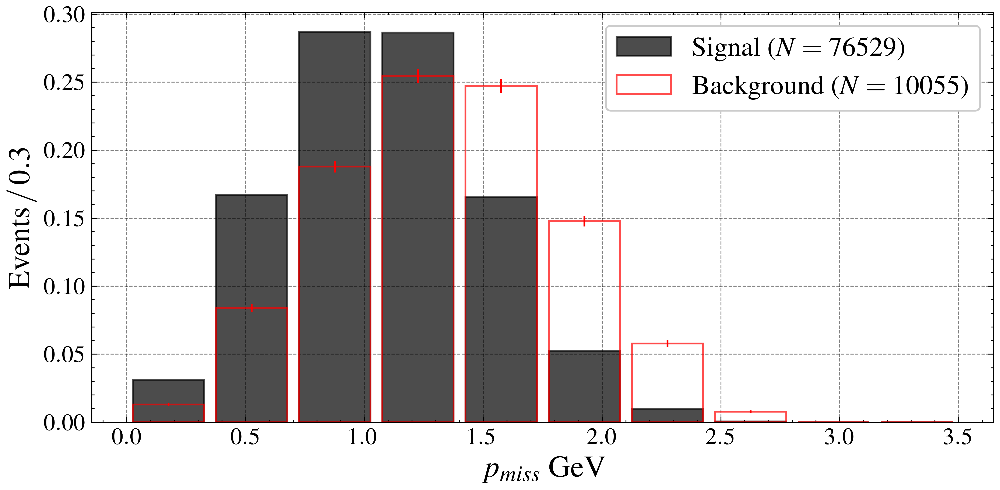

In [25]:
wbin = 0.3
a = 0
b = 3.5
bins = np.linspace(a, b, int((b-a)/wbin))

fig, ax = plt.subplots(1, figsize=(12/1.5, 6/1.5))



bin_centers_sig, counts_sig, N_sig = compute_histogram(
    sig, bins, "cmpmiss",
    filter_mask=((pc.field("E_gamma_in_ROE") < 0.2)) & mask_lep & (pc.field("is0") == 1),
    norm=True
)
ax.bar(
    bin_centers_sig, counts_sig,
    width=wbin, align='center',
    alpha=0.7, linewidth=1,
    edgecolor=colors[0], color=colors[0], ecolor=colors[0],
    label=f"Signal ($N = {N_sig}$)",
)

# Background
bin_centers_lep, counts_lep, N_lep = compute_histogram(
    lep, bins, "cmpmiss",
    filter_mask=mask & ((pc.field("E_gamma_in_ROE") < 0.2)) & mask_lep & (pc.field("is0") == 1),
    norm=True
)
ax.bar(
    bin_centers_lep, counts_lep,
    yerr=np.sqrt(counts_lep)/np.sqrt(N_lep),
    width=wbin, align='center',
    fill = False, alpha = 0.7, linewidth=1,
    edgecolor=colors[1], color=colors[1], ecolor=colors[1],
    label=f"Background ($N = {N_lep}$)"
)


ax.set_ylabel(f'$\\mathrm{{Events}}\\,/\\,{wbin}$')
ax.set_xlabel(r'$p_{miss} \ \mathrm{GeV}$')
ax.legend()

plt.tight_layout()
plt.show()

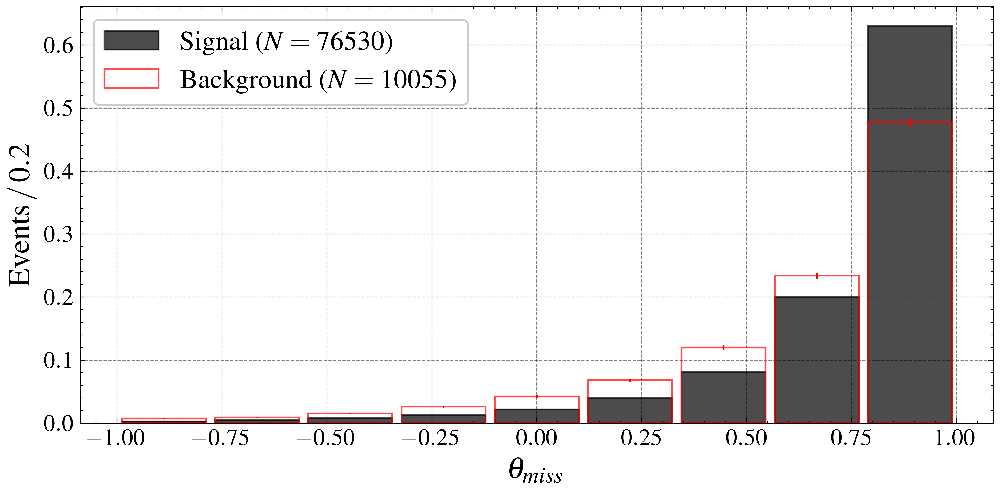

In [26]:
wbin = 0.2
a = -1
b = 1
bins = np.linspace(a, b, int((b-a)/wbin))

fig, ax = plt.subplots(1, figsize=(12/1.5, 6/1.5))

bin_centers_sig, counts_sig, N_sig = compute_histogram(
    sig, bins, "thetamiss",
    filter_mask=mask & ((pc.field("E_gamma_in_ROE") < 0.2)) & mask_lep & (pc.field("is0") == 1),
    norm=True
)
ax.bar(
    bin_centers_sig, counts_sig,
    width=wbin, align='center',
    alpha=0.7, linewidth=1,
    edgecolor=colors[0], color=colors[0], ecolor=colors[0],
    label=f"Signal ($N = {N_sig}$)",
)

# Background
bin_centers_lep, counts_lep, N_lep = compute_histogram(
    lep, bins, "thetamiss",
    filter_mask=mask & ((pc.field("E_gamma_in_ROE") < 0.2)) & mask_lep & (pc.field("is0") == 1),
    norm=True
)
ax.bar(
    bin_centers_lep, counts_lep,
    yerr=np.sqrt(counts_lep)/np.sqrt(N_lep),
    width=wbin, align='center',
    fill = False, alpha = 0.7, linewidth=1,
    edgecolor=colors[1], color=colors[1], ecolor=colors[1],
    label=f"Background ($N = {N_lep}$)"
)

ax.set_ylabel(f'$\\mathrm{{Events}}\\,/\\,{wbin}$')
ax.set_xlabel(r'$\theta_{miss}$')
ax.legend()

plt.tight_layout()
plt.show()

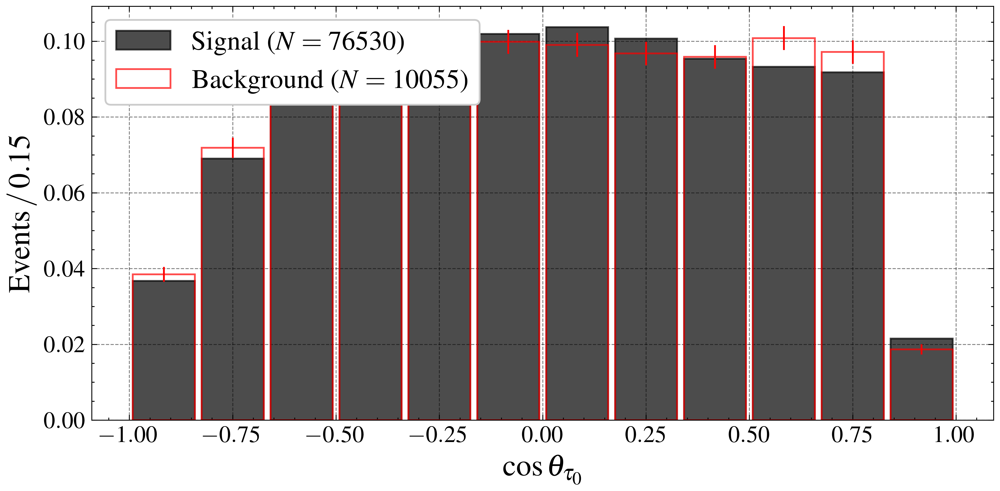

In [27]:
wbin = 0.15
a = -1
b = 1
bins = np.linspace(a, b, int((b-a)/wbin))

fig, ax = plt.subplots(1, figsize=(12/1.5, 6/1.5))

bin_centers_sig, counts_sig, N_sig = compute_histogram(
    sig, bins, "theta_tau_0",
    filter_mask=mask & ((pc.field("E_gamma_in_ROE") < 0.2)) & mask_lep & (pc.field("is0") == 1),
    norm=True
)
ax.bar(
    bin_centers_sig, counts_sig,
    width=wbin, align='center',
    alpha=0.7, linewidth=1,
    edgecolor=colors[0], color=colors[0], ecolor=colors[0],
    label=f"Signal ($N = {N_sig}$)",
)

# Background
bin_centers_lep, counts_lep, N_lep = compute_histogram(
    lep, bins, "theta_tau_0",
    filter_mask=mask & ((pc.field("E_gamma_in_ROE") < 0.2)) & mask_lep & (pc.field("is0") == 1),
    norm=True
)
ax.bar(
    bin_centers_lep, counts_lep,
    yerr=np.sqrt(counts_lep)/np.sqrt(N_lep),
    width=wbin, align='center',
    fill = False, alpha = 0.7, linewidth=1,
    edgecolor=colors[1], color=colors[1], ecolor=colors[1],
    label=f"Background ($N = {N_lep}$)"
)

ax.set_ylabel(f'$\\mathrm{{Events}}\\,/\\,{wbin}$')
ax.set_xlabel(r'$\cos \theta_{\tau_0} $')
ax.legend()

plt.tight_layout()
plt.show()

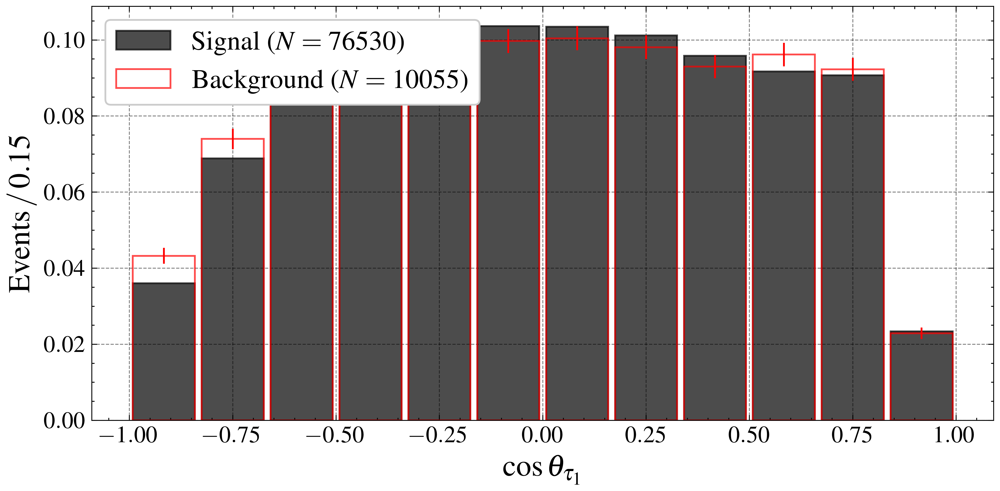

In [28]:
wbin = 0.15
a = -1
b = 1
bins = np.linspace(a, b, int((b-a)/wbin))

fig, ax = plt.subplots(1, figsize=(12/1.5, 6/1.5))

bin_centers_sig, counts_sig, N_sig = compute_histogram(
    sig, bins, "theta_tau_1",
    filter_mask=mask & ((pc.field("E_gamma_in_ROE") < 0.2)) & mask_lep & (pc.field("is0") == 1),
    norm=True
)
ax.bar(
    bin_centers_sig, counts_sig,
    width=wbin, align='center',
    alpha=0.7, linewidth=1,
    edgecolor=colors[0], color=colors[0], ecolor=colors[0],
    label=f"Signal ($N = {N_sig}$)",
)

# Background
bin_centers_lep, counts_lep, N_lep = compute_histogram(
    lep, bins, "theta_tau_1",
    filter_mask=mask & ((pc.field("E_gamma_in_ROE") < 0.2)) & mask_lep & (pc.field("is0") == 1),
    norm=True
)
ax.bar(
    bin_centers_lep, counts_lep,
    yerr=np.sqrt(counts_lep)/np.sqrt(N_lep),
    width=wbin, align='center',
    fill = False, alpha = 0.7, linewidth=1,
    edgecolor=colors[1], color=colors[1], ecolor=colors[1],
    label=f"Background ($N = {N_lep}$)"
)

ax.set_ylabel(f'$\\mathrm{{Events}}\\,/\\,{wbin}$')
ax.set_xlabel(r'$\cos \theta_{\tau_1} $')
ax.legend()

plt.tight_layout()
plt.show()

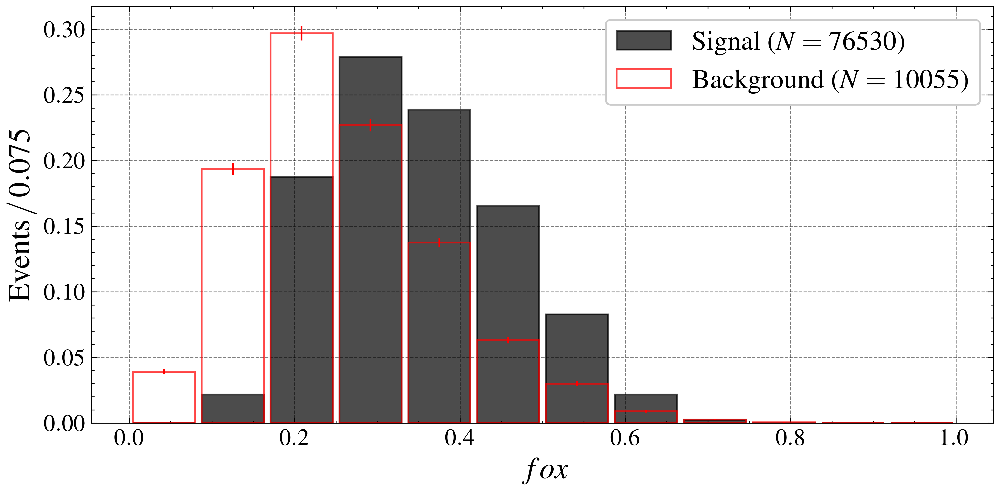

In [29]:
wbin = 0.075
a = 0
b = 1
bins = np.linspace(a, b, int((b-a)/wbin))

fig, ax = plt.subplots(1, figsize=(12/1.5, 6/1.5))

bin_centers_sig, counts_sig, N_sig = compute_histogram(
    sig, bins, "fox",
    filter_mask=mask & ((pc.field("E_gamma_in_ROE") < 0.2)) & mask_lep & (pc.field("is0") == 1),
    norm=True
)
ax.bar(
    bin_centers_sig, counts_sig,
    width=wbin, align='center',
    alpha=0.7, linewidth=1,
    edgecolor=colors[0], color=colors[0], ecolor=colors[0],
    label=f"Signal ($N = {N_sig}$)",
)

# Background
bin_centers_lep, counts_lep, N_lep = compute_histogram(
    lep, bins, "fox",
    filter_mask=mask & ((pc.field("E_gamma_in_ROE") < 0.2)) & mask_lep & (pc.field("is0") == 1),
    norm=True
)
ax.bar(
    bin_centers_lep, counts_lep,
    yerr=np.sqrt(counts_lep)/np.sqrt(N_lep),
    width=wbin, align='center',
    fill = False, alpha = 0.7, linewidth=1,
    edgecolor=colors[1], color=colors[1], ecolor=colors[1],
    label=f"Background ($N = {N_lep}$)"
)

ax.set_ylabel(f'$\\mathrm{{Events}}\\,/\\,{wbin}$')
ax.set_xlabel(r'$fox$')
ax.legend()

plt.tight_layout()
plt.show()

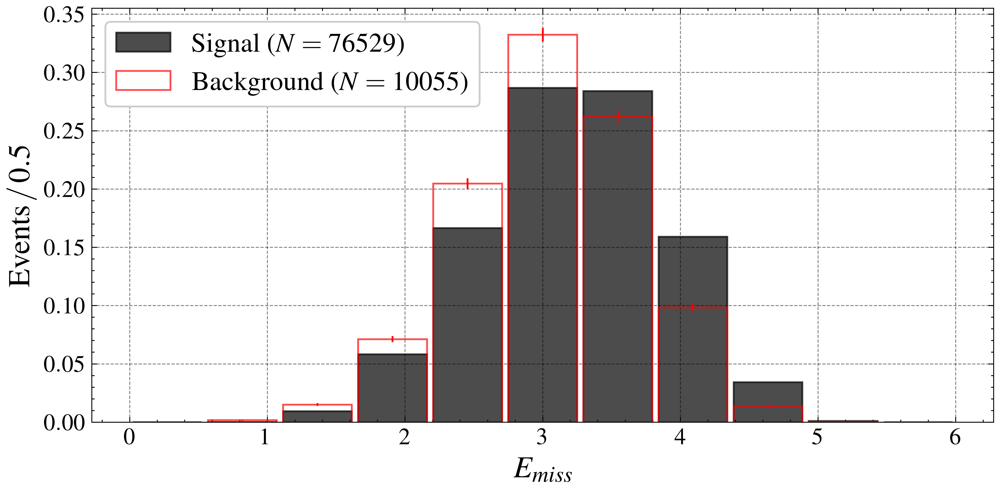

In [30]:
wbin = 0.5
a = 0
b = 6
bins = np.linspace(a, b, int((b-a)/wbin))

fig, ax = plt.subplots(1, figsize=(12/1.5, 6/1.5))

bin_centers_sig, counts_sig, N_sig = compute_histogram(
    sig, bins, "missedE",
    filter_mask=mask & ((pc.field("E_gamma_in_ROE") < 0.2)) & mask_lep & (pc.field("is0") == 1),
    norm=True
)
ax.bar(
    bin_centers_sig, counts_sig,
    width=wbin, align='center',
    alpha=0.7, linewidth=1,
    edgecolor=colors[0], color=colors[0], ecolor=colors[0],
    label=f"Signal ($N = {N_sig}$)",
)

# Background
bin_centers_lep, counts_lep, N_lep = compute_histogram(
    lep, bins, "missedE",
    filter_mask=mask & ((pc.field("E_gamma_in_ROE") < 0.2)) & mask_lep & (pc.field("is0") == 1),
    norm=True
)
ax.bar(
    bin_centers_lep, counts_lep,
    yerr=np.sqrt(counts_lep)/np.sqrt(N_lep),
    width=wbin, align='center',
    fill = False, alpha = 0.7, linewidth=1,
    edgecolor=colors[1], color=colors[1], ecolor=colors[1],
    label=f"Background ($N = {N_lep}$)"
)

ax.set_ylabel(f'$\\mathrm{{Events}}\\,/\\,{wbin}$')
ax.set_xlabel(r'$E_{miss}$')
ax.legend()

plt.tight_layout()
plt.show()

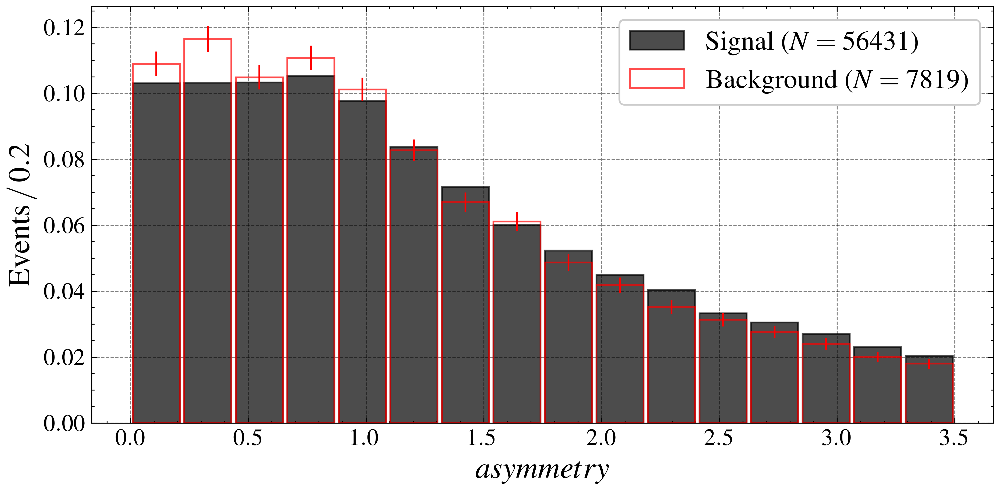

In [31]:
wbin = 0.2
a = 0
b = 3.5
bins = np.linspace(a, b, int((b-a)/wbin))

fig, ax = plt.subplots(1, figsize=(12/1.5, 6/1.5))

bin_centers_sig, counts_sig, N_sig = compute_histogram(
    sig, bins, "asymmetry", fun=lambda x: np.abs(x),
    filter_mask=mask & ((pc.field("E_gamma_in_ROE") < 0.2)) & mask_lep & (pc.field("is0") == 1),
    norm=True
)
ax.bar(
    bin_centers_sig, counts_sig,
    width=wbin, align='center',
    alpha=0.7, linewidth=1,
    edgecolor=colors[0], color=colors[0], ecolor=colors[0],
    label=f"Signal ($N = {N_sig}$)",
)

# Background
bin_centers_lep, counts_lep, N_lep = compute_histogram(
    lep, bins, "asymmetry", fun=lambda x: np.abs(x),
    filter_mask=mask & ((pc.field("E_gamma_in_ROE") < 0.2)) & mask_lep & (pc.field("is0") == 1),
    norm=True
)
ax.bar(
    bin_centers_lep, counts_lep,
    yerr=np.sqrt(counts_lep)/np.sqrt(N_lep),
    width=wbin, align='center',
    fill = False, alpha = 0.7, linewidth=1,
    edgecolor=colors[1], color=colors[1], ecolor=colors[1],
    label=f"Background ($N = {N_lep}$)"
)

ax.set_ylabel(f'$\\mathrm{{Events}}\\,/\\,{wbin}$')
ax.set_xlabel(r'$asymmetry$')
ax.legend()

plt.tight_layout()
plt.show()

In [32]:
bin_centers_sig = get_values(sig, ["p_tau_0", "p_tau_1"], filter_mask=((pc.field("E_gamma_in_ROE") < 0.2)) & mask_lep & (pc.field("is0") == 1))

bin_centers_lep = get_values(lep, ["p_tau_0", "p_tau_1"], filter_mask=((pc.field("E_gamma_in_ROE") < 0.2)) & mask_lep & (pc.field("is0") == 1))

Total data size: 0.74 MB
Total data size: 0.08 MB


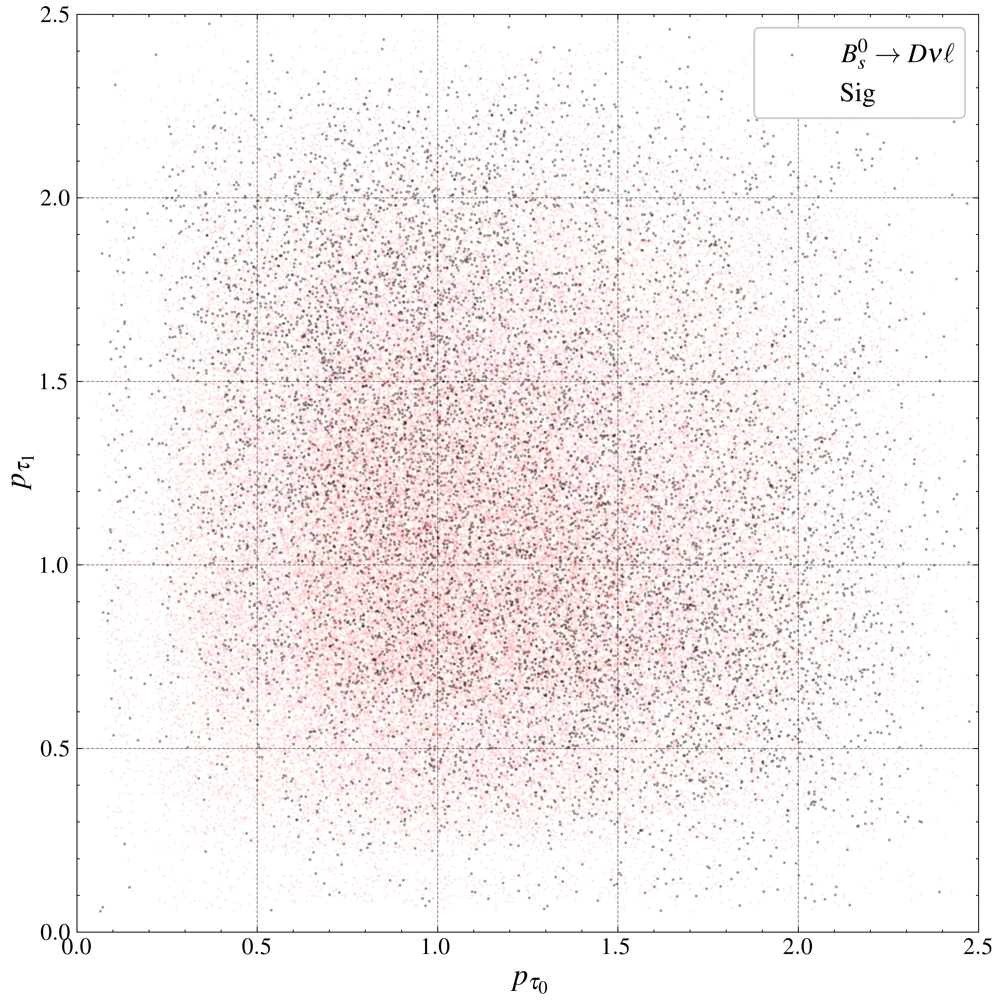

In [33]:
fig, ax = plt.subplots(1, figsize=(12/1.5, 12/1.5))

ax.scatter(bin_centers_lep.p_tau_0, bin_centers_lep.p_tau_1 , alpha=0.3, s=0.5, label = r"$B_s^0 \to D \nu \ell$")
ax.scatter(bin_centers_sig.p_tau_0, bin_centers_sig.p_tau_1, alpha=0.1, s=0.1, label = r"Sig")

ax.set_xlabel(r"$p_{\tau_0}$")
ax.set_ylabel(r"$p_{\tau_1}$")

ax.set_xlim(0,2.5)
ax.set_ylim(0,2.5)

ax.legend()

plt.tight_layout()
plt.show()


In [34]:
bin_centers_sig = get_values(sig, ["p_tau_0", "Chi_sq_0"], filter_mask=((pc.field("E_gamma_in_ROE") < 0.2)) & mask_lep & (pc.field("is0") == 1))
bin_centers_sig1 = get_values(sig, ["p_tau_1", "Chi_sq_1"], filter_mask=((pc.field("E_gamma_in_ROE") < 0.2)) & mask_lep & (pc.field("is0") == 1))



bin_centers_lep = get_values(lep, ["p_tau_0", "Chi_sq_0"], filter_mask=((pc.field("E_gamma_in_ROE") < 0.2)) & mask_lep & (pc.field("is0") == 1))
bin_centers_lep1 = get_values(lep, ["p_tau_1", "Chi_sq_1"], filter_mask=((pc.field("E_gamma_in_ROE") < 0.2)) & mask_lep & (pc.field("is0") == 1))

Total data size: 0.74 MB
Total data size: 0.74 MB
Total data size: 0.08 MB
Total data size: 0.08 MB


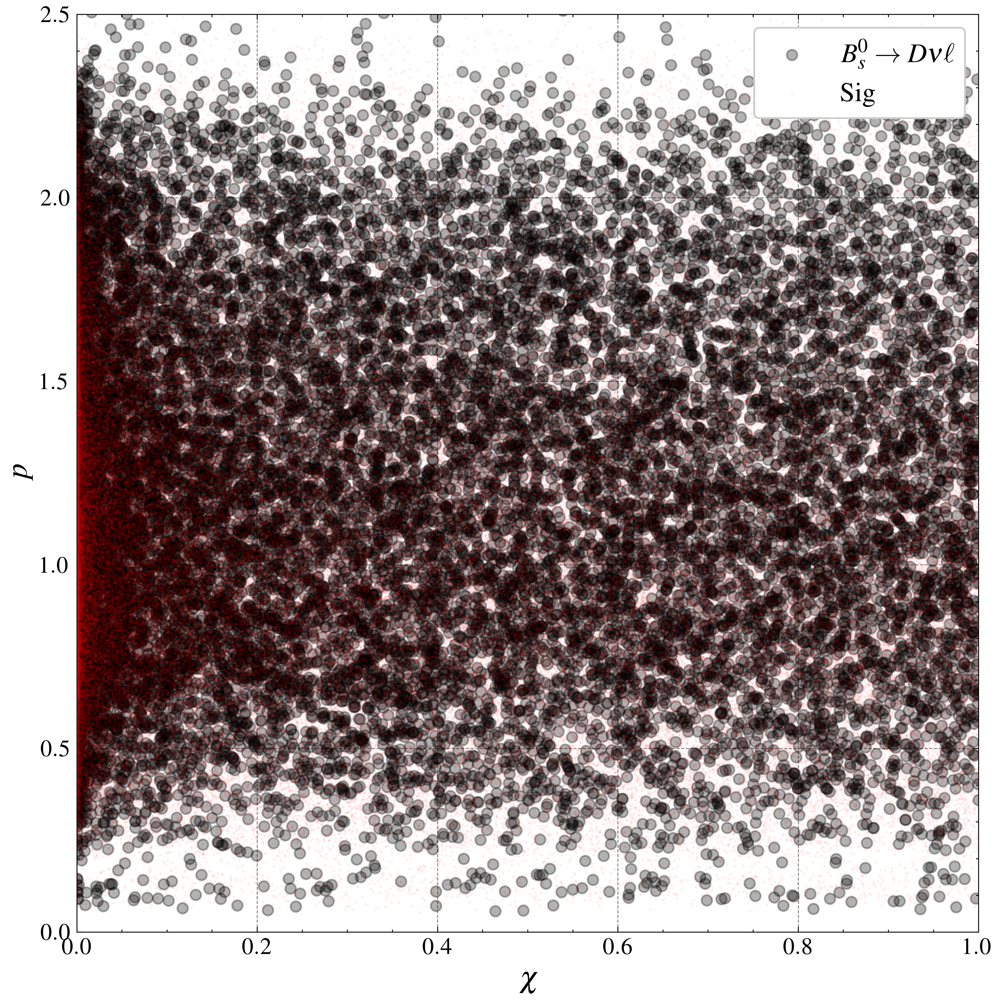

In [35]:
fig, ax = plt.subplots(1, figsize=(12/1.5, 12/1.5))

ax.scatter(np.concat([bin_centers_lep.Chi_sq_0, bin_centers_lep1.Chi_sq_1]), np.concat([bin_centers_lep.p_tau_0, bin_centers_lep1.p_tau_1]) , alpha=0.3, label = r"$B_s^0 \to D \nu \ell$")
ax.scatter(np.concat([bin_centers_sig.Chi_sq_0, bin_centers_sig1.Chi_sq_1]), np.concat([bin_centers_sig.p_tau_0, bin_centers_sig1.p_tau_1]), alpha=0.1, s=0.1, label = r"Sig")

ax.set_xlabel(r"$\chi$")
ax.set_ylabel(r"$p$")

ax.set_xlim(0,1)
ax.set_ylim(0,2.5)

ax.legend()

plt.tight_layout()
plt.show()


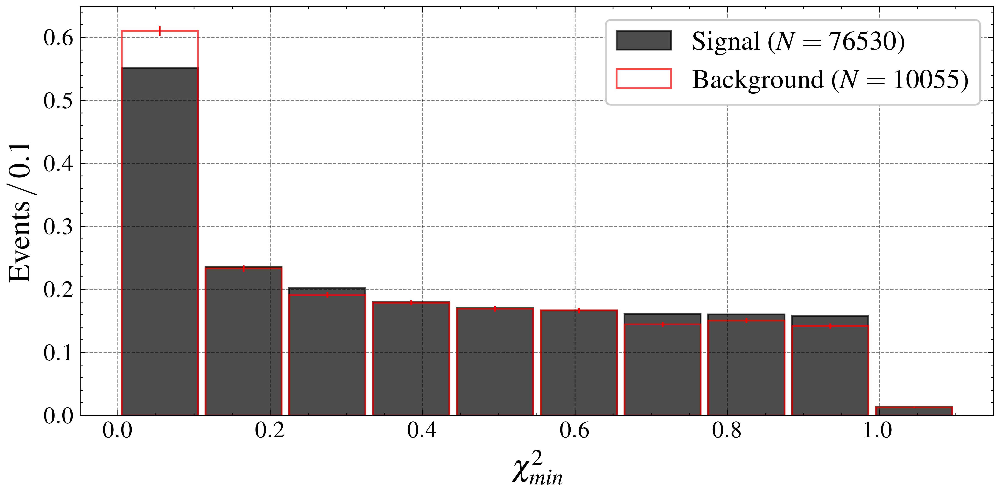

In [36]:
wbin = 0.1
a = 0
b = 1.1
bins = np.linspace(a, b, int((b-a)/wbin))

fig, ax = plt.subplots(1, figsize=(12/1.5, 6/1.5))


bin_centers_sig, counts_sig1, N_sig1 = compute_histogram(
    sig, bins, "Chi_sq_0",
    filter_mask=((pc.field("E_gamma_in_ROE") < 0.2)) & mask_lep & (pc.field("is0") == 1) & (pc.field("p_tau_0") < pc.field("p_tau_1")),
    norm=True, nanto=-1
) 
bin_centers_sig, counts_sig2, N_sig2 =compute_histogram(
    sig, bins, "Chi_sq_1",
    filter_mask=((pc.field("E_gamma_in_ROE") < 0.2)) & mask_lep & (pc.field("is0") == 1) & (pc.field("p_tau_1") < pc.field("p_tau_0")),
    norm=True, nanto=-1
)
ax.bar(
    bin_centers_sig, counts_sig1+counts_sig2,
    width=wbin, align='center',
    alpha=0.7, linewidth=1,
    edgecolor=colors[0], color=colors[0], ecolor=colors[0],
    label=f"Signal ($N = {N_sig1+N_sig2}$)",
)

bin_centers_lep, counts_lep1, N_lep1 = compute_histogram(
    lep, bins, "Chi_sq_0",
    filter_mask=((pc.field("E_gamma_in_ROE") < 0.2)) & mask_lep & (pc.field("is0") == 1) & (pc.field("p_tau_0") < pc.field("p_tau_1")),
    norm=True, nanto=-1
) 
bin_centers_lep, counts_lep2, N_lep2 = compute_histogram(
    lep, bins, "Chi_sq_1",
    filter_mask=((pc.field("E_gamma_in_ROE") < 0.2)) & mask_lep & (pc.field("is0") == 1) & (pc.field("p_tau_1") < pc.field("p_tau_0")),
    norm=True, nanto=-1
)
ax.bar(
    bin_centers_lep, counts_lep1+counts_lep2,
    yerr=np.sqrt(counts_lep1+counts_lep2)/np.sqrt(N_lep1+N_lep2),
    width=wbin, align='center',
    fill = False, alpha = 0.7, linewidth=1,
    edgecolor=colors[1], color=colors[1], ecolor=colors[1],
    label=f"Background ($N = {N_lep1+N_lep2}$)"
)

ax.set_ylabel(f'$\\mathrm{{Events}}\\,/\\,{wbin}$')
ax.set_xlabel(r'$\chi^2_{min}$')
ax.legend()

plt.tight_layout()
plt.show()


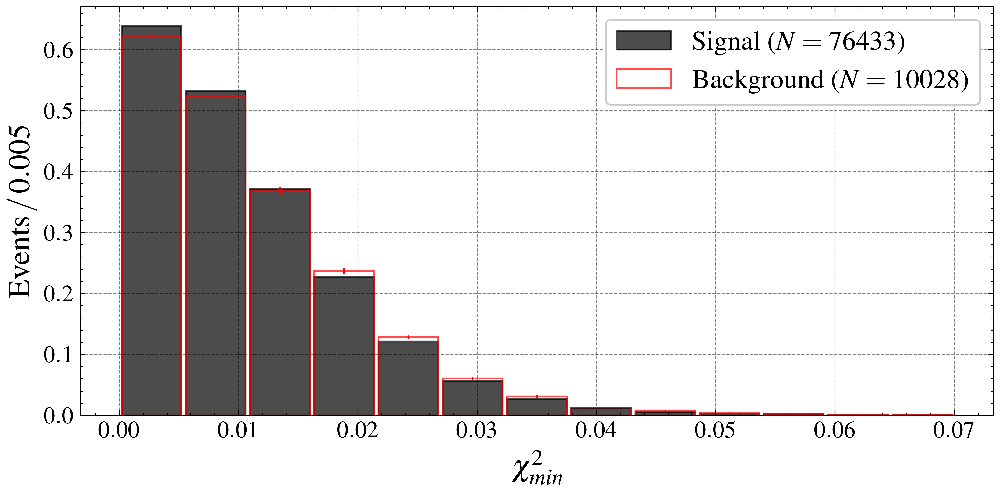

In [37]:
wbin = 0.005
a = 0
b = 0.07
bins = np.linspace(a, b, int((b-a)/wbin))

fig, ax = plt.subplots(1, figsize=(12/1.5, 6/1.5))


bin_centers_sig, counts_sig1, N_sig1 = compute_histogram(
    sig, bins, "dr0",
    filter_mask=((pc.field("E_gamma_in_ROE") < 0.2)) & mask_lep & (pc.field("is0") == 1) & (pc.field("p_tau_0") < pc.field("p_tau_1")),
    norm=True, nanto=-1
) 
bin_centers_sig, counts_sig2, N_sig2 =compute_histogram(
    sig, bins, "dr1",
    filter_mask=((pc.field("E_gamma_in_ROE") < 0.2)) & mask_lep & (pc.field("is0") == 1) & (pc.field("p_tau_1") < pc.field("p_tau_0")),
    norm=True, nanto=-1
)
ax.bar(
    bin_centers_sig, counts_sig1+counts_sig2,
    width=wbin, align='center',
    alpha=0.7, linewidth=1,
    edgecolor=colors[0], color=colors[0], ecolor=colors[0],
    label=f"Signal ($N = {N_sig1+N_sig2}$)",
)

bin_centers_lep, counts_lep1, N_lep1 = compute_histogram(
    lep, bins, "dr0",
    filter_mask=((pc.field("E_gamma_in_ROE") < 0.2)) & mask_lep & (pc.field("is0") == 1) & (pc.field("p_tau_0") < pc.field("p_tau_1")),
    norm=True, nanto=-1
) 
bin_centers_lep, counts_lep2, N_lep2 = compute_histogram(
    lep, bins, "dr1",
    filter_mask=((pc.field("E_gamma_in_ROE") < 0.2)) & mask_lep & (pc.field("is0") == 1) & (pc.field("p_tau_1") < pc.field("p_tau_0")),
    norm=True, nanto=-1
)
ax.bar(
    bin_centers_lep, counts_lep1+counts_lep2,
    yerr=np.sqrt(counts_lep1+counts_lep2)/np.sqrt(N_lep1+N_lep2),
    width=wbin, align='center',
    fill = False, alpha = 0.7, linewidth=1,
    edgecolor=colors[1], color=colors[1], ecolor=colors[1],
    label=f"Background ($N = {N_lep1+N_lep2}$)"
)

ax.set_ylabel(f'$\\mathrm{{Events}}\\,/\\,{wbin}$')
ax.set_xlabel(r'$\chi^2_{min}$')
ax.legend()

plt.tight_layout()
plt.show()


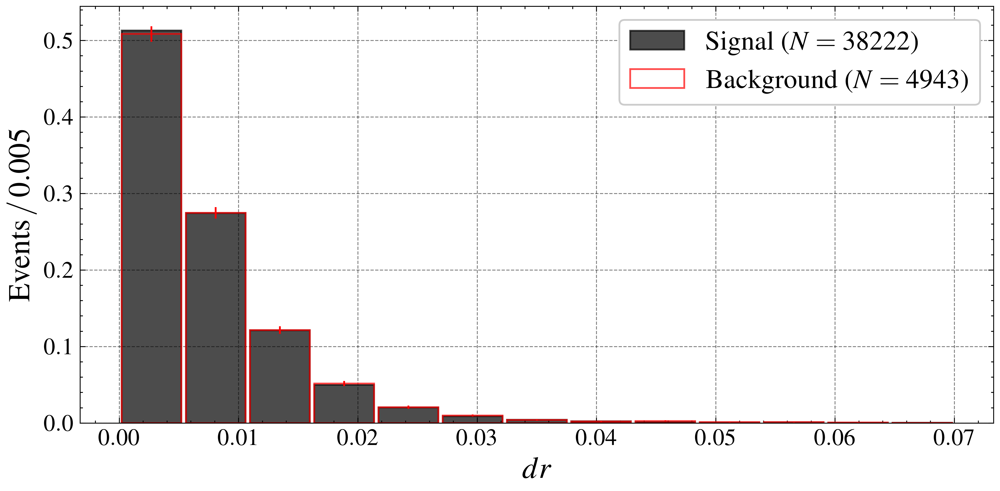

In [38]:
wbin = 0.005
a = 0
b = 0.07
bins = np.linspace(a, b, int((b-a)/wbin))

fig, ax = plt.subplots(1, figsize=(12/1.5, 6/1.5))


bin_centers_sig, counts_sig, N_sig = compute_histogram(
    sig, bins, ["dr0", "dr1"], fun=lambda x: np.abs(x[0]-x[1]),
    filter_mask=((pc.field("E_gamma_in_ROE") < 0.2)) & mask_lep & (pc.field("is0") == 1) & (pc.field("p_tau_0") > pc.field("p_tau_1")),
    norm=True, nanto=-1
) 
ax.bar(
    bin_centers_sig, counts_sig,
    width=wbin, align='center',
    alpha=0.7, linewidth=1,
    edgecolor=colors[0], color=colors[0], ecolor=colors[0],
    label=f"Signal ($N = {N_sig}$)",
)

bin_centers_bsbs, counts_bsbs, N_bsbs = compute_histogram(
    lep, bins, ["dr0", "dr1"], fun=lambda x: np.abs(x[0]-x[1]),
    filter_mask=((pc.field("E_gamma_in_ROE") < 0.2)) & mask_lep & (pc.field("is0") == 1) & (pc.field("p_tau_0") > pc.field("p_tau_1")),
    norm=True, nanto=-1
) 
ax.bar(
    bin_centers_bsbs, counts_bsbs,
    yerr=np.sqrt(counts_bsbs)/np.sqrt(N_bsbs),
    width=wbin, align='center',
    fill = False, alpha = 0.7, linewidth=1,
    edgecolor=colors[1], color=colors[1], ecolor=colors[1],
    label=f"Background ($N = {N_bsbs}$)"
)

ax.set_ylabel(f'$\\mathrm{{Events}}\\,/\\,{wbin}$')
ax.set_xlabel(r'$dr$')
ax.legend()

plt.tight_layout()
plt.show()


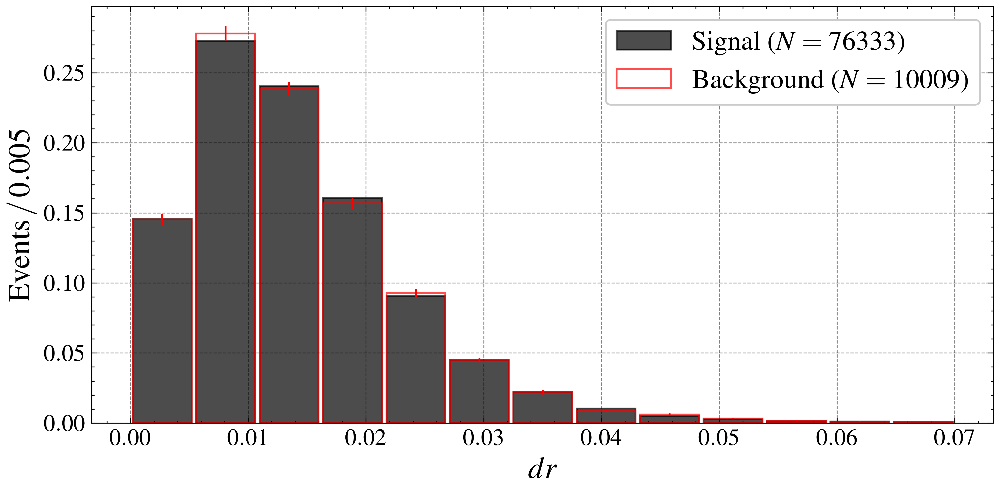

In [39]:
wbin = 0.005
a = 0
b = 0.07
bins = np.linspace(a, b, int((b-a)/wbin))

fig, ax = plt.subplots(1, figsize=(12/1.5, 6/1.5))


bin_centers_sig, counts_sig, N_sig = compute_histogram(
    sig, bins, ["dr0", "dr1"], fun=lambda x: np.max(x,axis=0),
    filter_mask=((pc.field("E_gamma_in_ROE") < 0.2)) & mask_lep & (pc.field("is0") == 1),
    norm=True, nanto=-1
) 
ax.bar(
    bin_centers_sig, counts_sig,
    width=wbin, align='center',
    alpha=0.7, linewidth=1,
    edgecolor=colors[0], color=colors[0], ecolor=colors[0],
    label=f"Signal ($N = {N_sig}$)",
)

bin_centers_bsbs, counts_bsbs, N_bsbs = compute_histogram(
    lep, bins, ["dr0", "dr1"], fun=lambda x: np.max(x,axis=0),
    filter_mask=((pc.field("E_gamma_in_ROE") < 0.2)) & mask_lep & (pc.field("is0") == 1),
    norm=True, nanto=-1
) 
ax.bar(
    bin_centers_bsbs, counts_bsbs,
    yerr=np.sqrt(counts_bsbs)/np.sqrt(N_bsbs),
    width=wbin, align='center',
    fill = False, alpha = 0.7, linewidth=1,
    edgecolor=colors[1], color=colors[1], ecolor=colors[1],
    label=f"Background ($N = {N_bsbs}$)"
)

ax.set_ylabel(f'$\\mathrm{{Events}}\\,/\\,{wbin}$')
ax.set_xlabel(r'$dr$')
ax.legend()

plt.tight_layout()
plt.show()


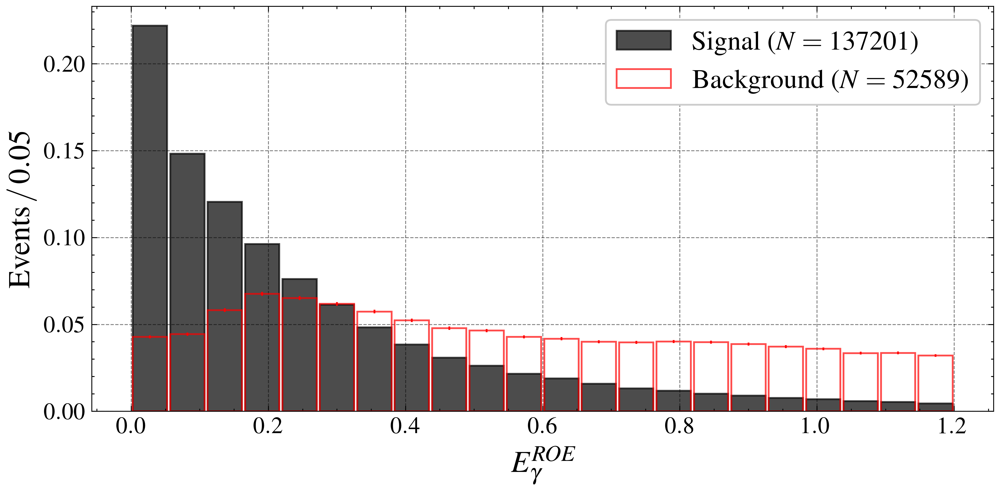

In [40]:
wbin = 0.05
a = 0
b = 1.2
bins = np.linspace(a, b, int((b-a)/wbin))

fig, ax = plt.subplots(1, figsize=(12/1.5, 6/1.5))


bin_centers_sig, counts_sig, N_sig = compute_histogram(
    sig, bins, "E_gamma_in_ROE",
    filter_mask=(mask_lep & (pc.field("is0") == 1)),
    norm=True, nanto=-1
) 
ax.bar(
    bin_centers_sig, counts_sig,
    width=wbin, align='center',
    alpha=0.7, linewidth=1,
    edgecolor=colors[0], color=colors[0], ecolor=colors[0],
    label=f"Signal ($N = {N_sig}$)",
)

bin_centers_bsbs, counts_bsbs, N_bsbs = compute_histogram(
    lep, bins, "E_gamma_in_ROE",
    filter_mask=(mask_lep & (pc.field("is0") == 1)),
    norm=True, nanto=-1
) 
ax.bar(
    bin_centers_bsbs, counts_bsbs,
    yerr=np.sqrt(counts_bsbs)/np.sqrt(N_bsbs),
    width=wbin, align='center',
    fill = False, alpha = 0.7, linewidth=1,
    edgecolor=colors[1], color=colors[1], ecolor=colors[1],
    label=f"Background ($N = {N_bsbs}$)"
)

ax.set_ylabel(f'$\\mathrm{{Events}}\\,/\\,{wbin}$')
ax.set_xlabel(r'$E_{\gamma}^{ROE}$')
ax.legend()

plt.tight_layout()
plt.show()
